参考  
https://github.com/soroushj/python-opencv-numpy-example/blob/master/unsharpmask.py

In [1]:
from PIL import Image, ImageFilter
import numpy as np

import matplotlib.pyplot as plt

In [2]:
im1 = Image.open("./data/anise-2785512_1920.jpg")
im1.size

(1920, 1280)

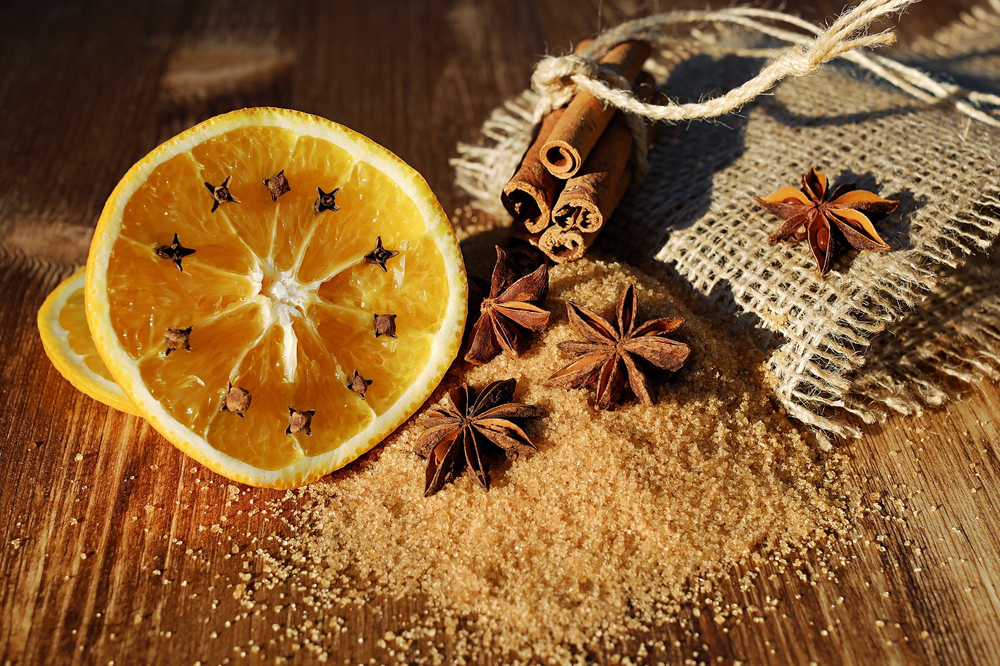

In [4]:
im1
# plt.imshow(im1)
# plt.show()

In [5]:
# 5*5 blur
N = 5
_kernel = np.array([[1,  4,  6,  4, 1],
                    [4, 16, 24, 16, 4],
                    [6, 24, 36, 24, 6],
                    [4, 16, 24, 16, 4],
                    [1,  4,  6,  4, 1]])/255
kernel = ImageFilter.Kernel(size=(N,N), kernel=_kernel.flatten())
img_gaussian_blur25 = im1.filter(kernel)

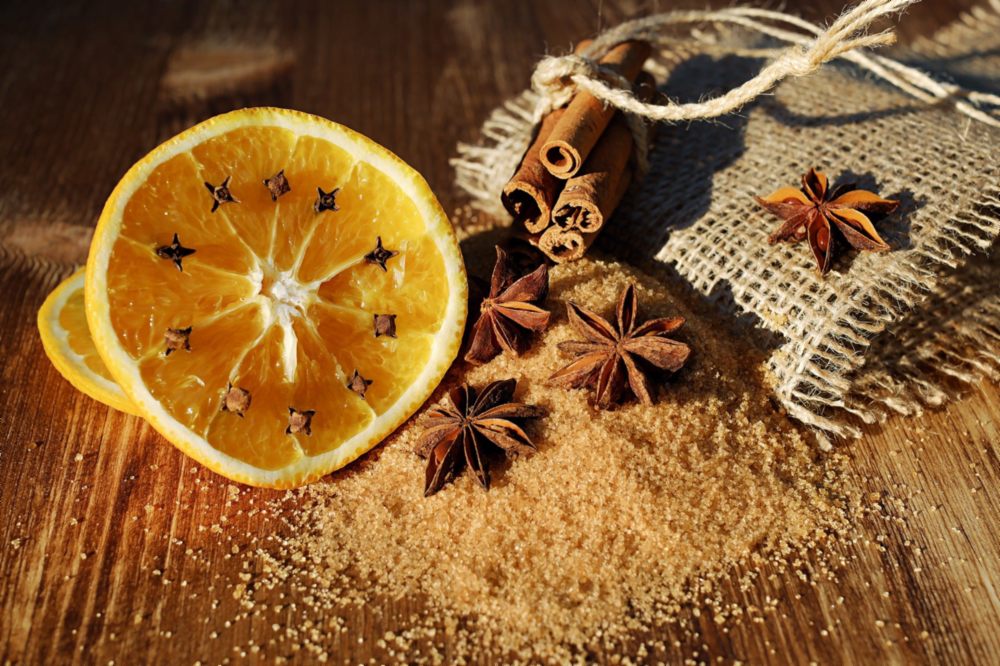

In [7]:
img_gaussian_blur25
# plt.imshow(img_gaussian_blur25)
# plt.show()

In [8]:
im1_array = np.array(im1)
im1_gaussian_blured = np.array(im1.filter(ImageFilter.GaussianBlur()))
im1_box_blured = np.array(im1.filter(ImageFilter.BoxBlur(radius=2)))
im1_blured = np.array(im1.filter(ImageFilter.BLUR()))

In [17]:
percent = 100
amount = float(percent/100)
result = im1_array.copy()
im1_sharpened = float(amount+1)*im1_array - amount*im1_blured
im1_sharpened = np.maximum(im1_sharpened, np.zeros(im1_sharpened.shape))
im1_sharpened = np.minimum(im1_sharpened, 255 * np.ones(im1_sharpened.shape))
im1_sharpened = Image.fromarray(im1_sharpened.round().astype(np.uint8))

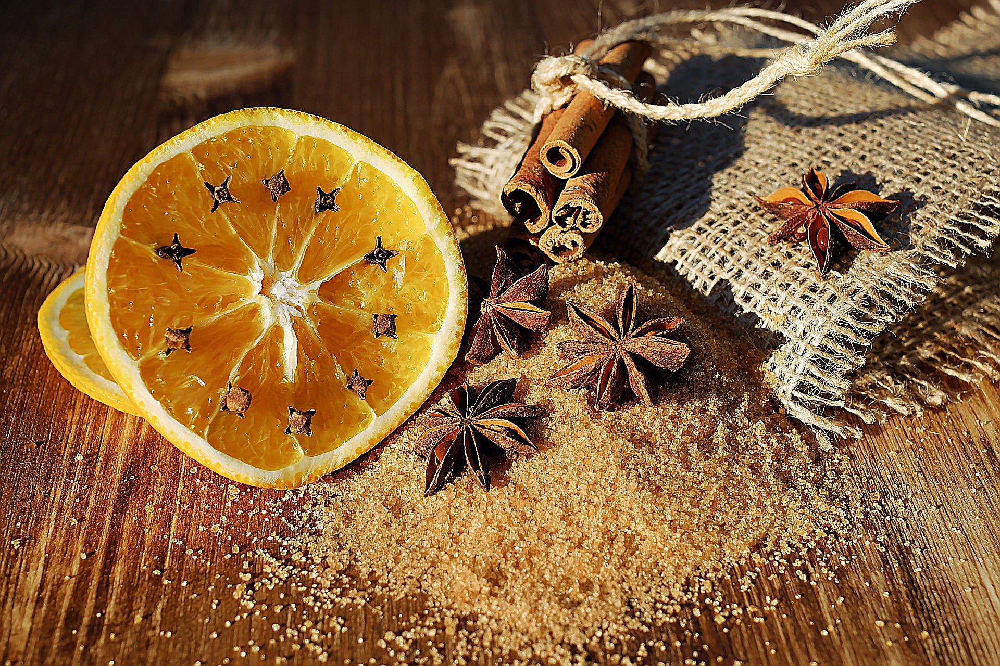

In [22]:
im1_sharpened

In [23]:
im1_sharpened.save("data/task6/sharpened100.jpg", format='JPEG')

In [35]:
percent = 100
amount = float(percent/100)
result = im1_array.copy()
im1_sharpened = float(amount+1)*im1_array - amount*im1_blured
im1_sharpened = np.maximum(im1_sharpened, np.zeros(im1_sharpened.shape))
im1_sharpened = np.minimum(im1_sharpened, 255 * np.ones(im1_sharpened.shape))
im1_sharpened = Image.fromarray(im1_sharpened.round().astype(np.uint8))

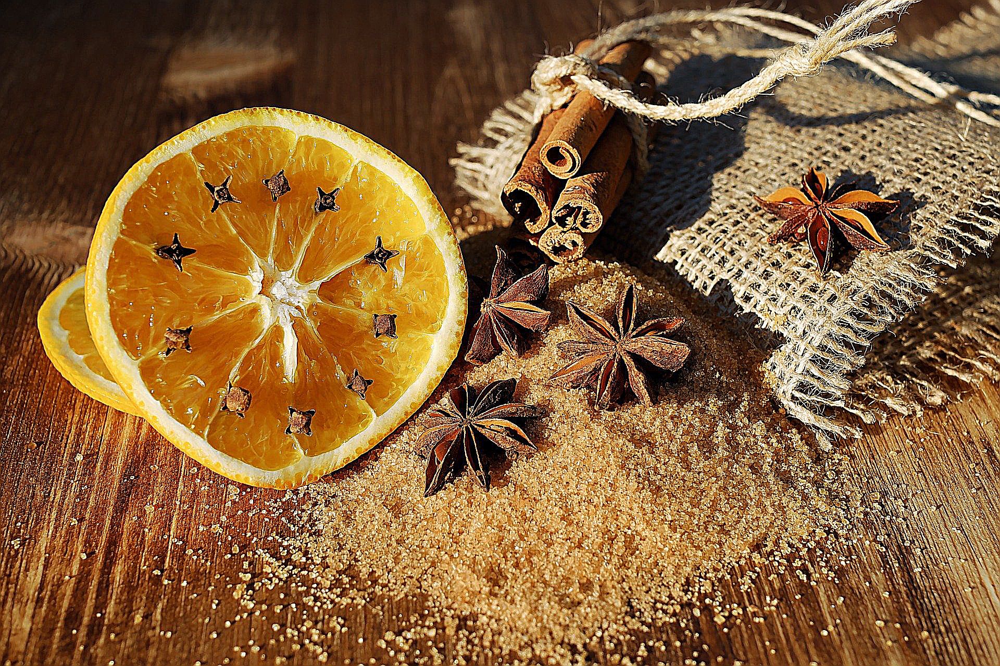

In [36]:
im1_sharpened

In [27]:
im1_sharpened.save("data/task6/sharpened150.jpg", format='JPEG')

In [28]:
# im1.filter(ImageFilter.UnsharpMask(percent=100))
# plt.imshow(im1.filter(ImageFilter.UnsharpMask(percent=400)))
# plt.show()

## 先鋭化フィルタのカーネルを作成する

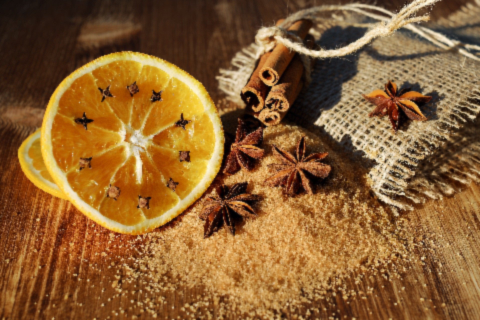

In [79]:
im1_minisize = im1.resize((int(1920/4), int(1280/4)))
im1_minisize = im1_minisize.filter(ImageFilter.GaussianBlur(radius=0.7))
im1_minisize

In [106]:
# 3*3 unsharp mask
N = 3
k = 2.0
_kernel = np.array([[-k/9, -k/9, -k/9],
                   [-k/9, 1+8*k/9, -k/9],
                   [-k/9, -k/9, -k/9]])
kernel = ImageFilter.Kernel(size=(N,N), kernel=_kernel.flatten())
img_sharped = im1_minisize.filter(kernel)

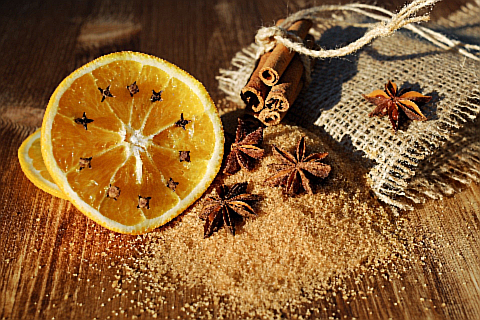

In [107]:
img_sharped.save('data/task6/sharpened200.jpg')
img_sharped

In [108]:
# 5*5 unsharp mask
N = 5
k = 2.0
_kernel = np.array([[-k/25, -k/25,    -k/25, -k/25, -k/25],
                    [-k/25, -k/25,    -k/25, -k/25, -k/25],
                    [-k/25, -k/25, 1+24*k/25, -k/25, -k/25],
                    [-k/25, -k/25,    -k/25, -k/25, -k/25],
                    [-k/25, -k/25,    -k/25, -k/25, -k/25]])
kernel = ImageFilter.Kernel(size=(N,N), kernel=_kernel.flatten())
img_sharped = im1_minisize.filter(kernel)

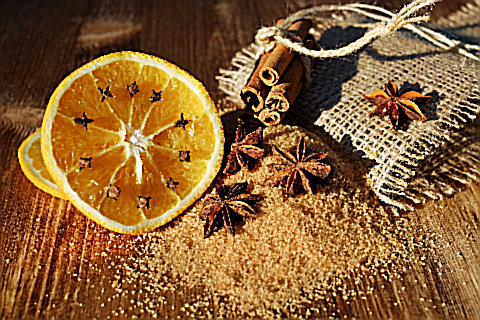

In [110]:
img_sharped.save('data/task6/sharpened200_25.jpg')
img_sharped